# ECS7020P mini-project submission

The mini-project has two separate components:


1.   **Basic component** [6 marks]: Using the MLEnd London Sounds dataset, build a machine learning pipeline that takes as an input an audio segment and predicts whether the audio segment has been recorded indoors or outdoors.
2.   **Advanced component** [10 marks]: Formulate your own machine learning problem and build a machine learning solution using the MLEnd London Sounds dataset. 

Your submission will consist of two Jupyter notebooks, one for the basic component and another one for advanced component. Please **name each notebook**:

* ECS7020P_miniproject_basic.ipynb
* ECS7020P_miniproject_advanced.ipynb

then **zip and submit them toghether**.

Each uploaded notebook should include: 

*   **Text cells**, describing concisely each step and results.
*   **Code cells**, implementing each step.
*   **Output cells**, i.e. the output from each code cell.

and **should have the structure** indicated below. Notebooks might not be run, please make sure that the output cells are saved.

How will we evaluate your submission?

*   Conciseness in your writing (10%).
*   Correctness in your methodology (30%).
*   Correctness in your analysis and conclusions (30%).
*   Completeness (10%).
*   Originality (10%).
*   Efforts to try something new (10%).

Suggestion: Why don't you use **GitHub** to manage your project? GitHub can be used as a presentation card that showcases what you have done and gives evidence of your data science skills, knowledge and experience. 

Each notebook should be structured into the following 9 sections:


# 1 Author

**Student Name**:  
**Student ID**:  



# 2 Problem formulation

Describe the machine learning problem that you want to solve and explain what's interesting about it.

# 3 Machine Learning pipeline

Describe your ML pipeline. Clearly identify its input and output, any intermediate stages (for instance, transformation -> models), and intermediate data moving from one stage to the next. It's up to you to decide which stages to include in your pipeline. 

# 4 Transformation stage

Describe any transformations, such as feature extraction. Identify input and output. Explain why you have chosen this transformation stage.

# 5 Modelling

Describe the ML model(s) that you will build. Explain why you have chosen them.

# 6 Methodology

Describe how you will train and validate your models, how model performance is assesssed (i.e. accuracy, confusion matrix, etc)

# 7 Dataset

Describe the dataset that you will use to create your models and validate them. If you need to preprocess it, do it here. Include visualisations too. You can visualise raw data samples or extracted features.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import os, sys, re, pickle, glob
import urllib.request
import zipfile

import IPython.display as ipd
from tqdm import tqdm
import librosa

In [ ]:
sample_path = 'MLEndLS/*.wav'
files = glob.glob(sample_path)
len(files)

MLENDLS_df = pd.read_csv('./MLEndLS.csv').set_index('file_id') 

def getPitch(x,fs,winLen=0.02):
  #winLen = 0.02 
  p = winLen*fs
  frame_length = int(2**int(p-1).bit_length())
  hop_length = frame_length//2
  f0, voiced_flag, voiced_probs = librosa.pyin(y=x, fmin=80, fmax=450, sr=fs,
                                                 frame_length=frame_length,hop_length=hop_length)
  times = librosa.times_like(f0)
  return f0,voiced_flag

def getXy(files,labels_file, scale_audio=False, onlySingleDigit=False):
  X,y,new_files =[],[],[]
  for file in tqdm(files):
    fileID = file.split('/')[-1]
    file_name = file.split('/')[-1]

    yi = labels_file.loc[fileID]['in_out']=='indoor'

    fs = None # if None, fs would be 22050
    x, fs = librosa.load(file,sr=fs)
    f0, voiced_flag = None, None
    
    if scale_audio: x = x/np.max(np.abs(x))
        
    try:
        f0, voiced_flag = getPitch(x,fs,winLen=0.02)
    except:
        print(file_name)
        continue

    power = np.sum(x**2)/len(x)
    pitch_mean = np.nanmean(f0) if np.mean(np.isnan(f0))<1 else 0
    pitch_std  = np.nanstd(f0) if np.mean(np.isnan(f0))<1 else 0
    voiced_fr = np.mean(voiced_flag)

    xi = [power,pitch_mean,pitch_std,voiced_fr]
    X.append(xi)
    y.append(yi)
    new_files.append(file)

  return np.array(X),np.array(y),new_files

X,y,new_files = getXy(files[0:], labels_file=MLENDLS_df, scale_audio=True, onlySingleDigit=True)

In [ ]:
def normalize(infile, rms_level=0):
    """
    Normalize the signal given a certain technique (peak or rms).
    Args:
        - infile    (str) : input filename/path.
        - rms_level (int) : rms level in dB.
    """
    fs = None
#     fs, sig = read_file(filename=infile)
    sig, fs = librosa.load(infile,sr=fs)
    print(fs)
    r = 10**(rms_level / 10.0)
    a = np.sqrt( (len(sig) * r**2) / np.sum(sig**2) )
    y = sig * a
    
    display(ipd.Audio(y, fs))
    
    #     output_file_path = os.path.dirname('MLS_norm')
    #     name_attribute = "output_file.wav"

    #     write_file(output_file_path=output_file_path,
    #                input_file_name=infile,
    #                name_attribute=name_attribute,
    #                sig=y,
    #                fs=fs)
    
normalize("MLEndLS/1234.wav")

In [2]:
X_backup = X
y_backup = y

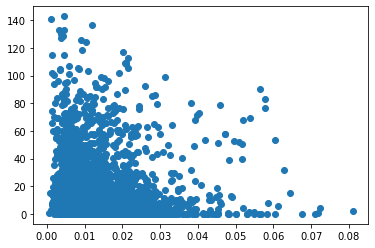

In [20]:
# ls = np.linspace(min(X.T[0]), max(X.T[0]), X.T[0])
plt.scatter(X.T[0], X.T[2])
plt.show()

(321930,)


[76.45035   12.092853   8.8277855 ... 14.157753   8.8277855 12.092853 ]
(307818,)


[ 7.7565765 34.457897  32.85741   ... 13.110716  32.85741   34.457897 ]
(336042,)


[4.721512  4.4574423 4.5237594 ... 3.6747422 4.5237594 4.4574423]
(364707,)


[16.17022  16.370636 14.085324 ... 11.960916 14.085324 16.370636]
(325899,)


[3.8356314 2.7237232 1.2440972 ... 1.2504176 1.2440972 2.7237232]
(661059,)


[ 1.6057196 10.442893   3.1768568 ...  4.898391   3.1768568 10.442893 ]
(347067,)


[0.5781856  1.6442586  1.3223695  ... 0.65663946 1.3223695  1.6442586 ]
(331632,)


[ 4.721863  11.264567  14.2489195 ... 11.540317  14.2489195 11.264567 ]
(367794,)


[10.134323  12.157955  12.0301075 ... 10.038627  12.0301075 12.157955 ]
(408807,)


[2.7360077 1.3428953 3.5991693 ... 3.2909298 3.5991693 1.3428953]


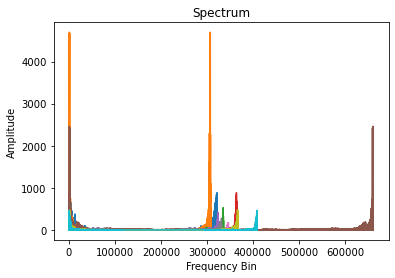

In [65]:
from scipy.fft import fft, ifft
import librosa.display
import numpy as np

sample_path = 'MLEndLS/*.wav'
files = glob.glob(sample_path)

# n=12
for n in range(10,20):
    fs = None
    a, fs = librosa.load(files[n],sr=fs)

#     librosa.display.waveshow(a, sr=fs, color='b')
#     plt.show()

    ft = np.abs(fft(a))
    print(ft.shape)
    plt.plot(ft);
    plt.title('Spectrum');
    plt.xlabel('Frequency Bin');
    plt.ylabel('Amplitude');

    display(ipd.Audio(files[n]))

    print(ft)

In [3]:
MLENDLS_df = pd.read_csv('./MLEndLS.csv').set_index('file_id') 
MLENDLS_df

,area,spot,in_out,Participant
file_id,,,,
0001.wav,british,street,outdoor,S151
0002.wav,kensington,dinosaur,indoor,S127
0003.wav,campus,square,outdoor,S18
0004.wav,kensington,hintze,indoor,S179
0005.wav,campus,square,outdoor,S176
...,...,...,...,...
2496.wav,westend,trafalgar,outdoor,S151
2497.wav,campus,square,outdoor,S6
2498.wav,westend,national,indoor,S96


In [140]:
from sklearn.preprocessing import MinMaxScaler
import librosa.display

sample_path = 'MLEndLS/*.wav'
files = glob.glob(sample_path)
fs = None


scaler = MinMaxScaler()

aud_data = []
labels = []

# n=12
for n in range(0,len(files)):
#     print(MLENDLS_df.loc[files[n].split('/')[-1]])
    a, fs = librosa.load(files[n],sr=fs)
#     librosa.display.waveshow(a)
#     plt.show()
#     A = librosa.stft(a)
#     Xdb = librosa.amplitude_to_db(abs(A))
    # plt.figure(figsize=(14, 5))
#     librosa.display.specshow(Xdb, sr=fs, x_axis='time', y_axis='hz')
#     plt.show()
    
    mel_spect = librosa.feature.melspectrogram(y=a, sr=fs, n_fft=2048, hop_length=1024)
    mel_spect = librosa.power_to_db(mel_spect, ref=np.max)
#     print(mel_spect[:,:260].shape)
#     display(ipd.Audio(files[n]))
    mel_spect = mel_spect[:,:260].T
#     print(mel_spect.shape)
#     print(mel_spect.T.shape)
    mel_spect = mel_spect.reshape(1,mel_spect.shape[0]*mel_spect.shape[1])
#     print(len(mel_spect[0]))
    if len(mel_spect[0]) < 33280:
        continue
    #     print(mel_spect[0])
    aud_data.append(mel_spect[0])
#     print(mel_spect[0])
    labels.append(MLENDLS_df.loc[files[n].split('/')[-1]].in_out)
    print(n)

#     librosa.display.specshow(mel_spect, y_axis='mel', fmax=8000, x_axis='time');
#     plt.title('Mel Spectrogram');
#     plt.colorbar(format='%+2.0f dB');
#     plt.show()
    

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
27

1872
1873
1874
1875
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061
2062
2063
2064
2065
2066
2067
2068
2069
2070
2071
2072
2073
2074


In [5]:
import librosa.display

sample_path = 'MLEndLS/*.wav'
files = glob.glob(sample_path)
fs = None

aud_data = []
labels = []

# n=12
# for n in range(0,100):

for n in range(0,len(files)):
    a, fs = librosa.load(files[n],sr=fs)    
    d_mfcc = librosa.feature.mfcc(y=a, sr=fs)
    d_mfcc = librosa.power_to_db(d_mfcc, ref=np.max)
    d_mfcc = d_mfcc[:,:536].T
    d_mfcc = d_mfcc.reshape(1,d_mfcc.shape[0]*d_mfcc.shape[1])
    
    if len(d_mfcc[0]) < 10720:
        continue

    aud_data.append(d_mfcc[0])
    labels.append(MLENDLS_df.loc[files[n].split('/')[-1]].in_out)
    
print("Done")

In [15]:
import pandas as pd
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

numComponents = 5
pca = PCA(n_components=numComponents)
pca.fit(aud_data)

projected = pca.transform(aud_data)
projected = pd.DataFrame(projected,columns=['pc1','pc2','pc3','pc4','pc5'],index=range(1,len(aud_data)+1))
# projected['label'] = labels
display(projected)

# colors = {'outdoor':'r', 'indoor':'b'}

# for in_out in colors:
#     d = projected[projected['label']==in_out]
#     plt.scatter(d['pc1'],d['pc2'],c=colors[in_out],s=1)
    


,pc1,pc2,pc3,pc4,pc5
1,496.273687,-1627.158133,-663.147781,-642.597630,553.104163
2,-1427.422455,570.942963,338.524285,793.816427,-744.958189
3,148.189670,137.582675,-708.643632,1054.707154,650.125209
4,1299.744997,-186.685546,-455.963522,590.182121,431.021410
5,985.473985,-1217.602096,-243.111914,143.716095,90.001784
...,...,...,...,...,...
2475,578.036888,81.470391,505.227405,160.768457,-212.988119
2476,-852.497144,-279.227472,-792.559737,-528.714587,-72.543115
2477,1289.524840,245.191524,448.767692,-283.899277,25.959740
2478,467.655667,-60.914381,520.583016,470.970906,-254.453594


Sampling Rate:  44100


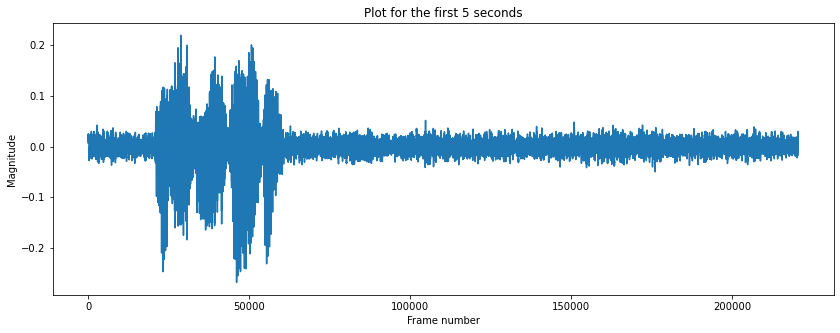

In [61]:
import librosa
from matplotlib import pyplot as plt

sample_path = 'MLEndLS/*.wav'
files = glob.glob(sample_path)

n=12
fs = None
a, fs = librosa.load(files[n],sr=fs)

print('Sampling Rate: ', fs)
plt.figure(figsize=(14, 5))
plt.plot(a[:fs * 5])
plt.title('Plot for the first 5 seconds')
plt.xlabel('Frame number')
plt.ylabel('Magnitude')
plt.show()

In [33]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification

from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(projected,labels,test_size=0.2)
# print(X_train.shape, X_val.shape, y_train.shape, y_val.shape)

clf = RandomForestClassifier(max_depth=7)
clf.fit(X_train,y_train)

yt_p = clf.predict(X_train)
yv_p = clf.predict(X_val)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))

Training Accuracy 0.8088754412506304
Validation  Accuracy 0.7338709677419355


In [9]:
from sklearn.cluster import KMeans
import numpy as np

n=30

kmeans = KMeans(n_clusters=2, random_state=0).fit(X)
print(kmeans.labels_[n])

display(ipd.Audio(new_files[n]))

0


# 8 Results

Carry out your experiments here, explain your results.

# 9 Conclusions

Your conclusions, improvements, etc should go here